# 17 FOXN1^LacZ QC

## Notebook setup

In [1]:
import warnings
warnings.filterwarnings('ignore')

import scanpy as sc
import scanpy.external as sce
import numpy as np
import pandas as pd
import warnings, scipy.sparse as sp, matplotlib, matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.pyplot import rc_context
from collections import Counter
import matplotlib.font_manager
import pyreadr
import rpy2
from rpy2.robjects.packages import importr
import rpy2.robjects as robjects
#import magic
#import seaborn as sns
import palantir
import loompy
#from scipy.sparse import csgraph

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['font.sans-serif'] = 'Arial'
matplotlib.rc('font', size=14)

pd.set_option('display.max_rows', 200)

sc.set_figure_params(dpi=80, dpi_save=300, color_map='Spectral_r', vector_friendly=True, transparent=True)
sc.settings.verbosity = 0 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.20.2 scipy==1.5.3 pandas==1.4.4 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.9.11 pynndescent==0.5.7


In [2]:
# preset color palettes and color maps
user_defined_palette =  [ '#F6222E', '#16FF32', '#3283FE', '#FEAF16', '#BDCDFF', '#3B00FB', '#1CFFCE', '#C075A6', '#F8A19F', '#B5EFB5', '#FBE426', '#C4451C', 
                          '#2ED9FF', '#c1c119', '#8b0000', '#FE00FA', '#1CBE4F', '#1C8356', '#0e452b', '#AA0DFE', '#B5EFB5', '#325A9B', '#90AD1C']

user_defined_cmap_markers = LinearSegmentedColormap.from_list('mycmap', ["#E6E6FF", "#CCCCFF", "#B2B2FF", "#9999FF",  "#6666FF",   "#3333FF", "#0000FF"])
user_defined_cmap_degs = LinearSegmentedColormap.from_list('mycmap', ["#0000FF", "#3333FF", "#6666FF", "#9999FF", "#B2B2FF", "#CCCCFF", "#E6E6FF", "#E6FFE6", "#CCFFCC", "#B2FFB2", "#99FF99", "#66FF66", "#33FF33", "#00FF00"])

In [3]:
%matplotlib inline 

## Load cellranger output files

In [4]:
from pathlib import Path

Foxn1LacZ_list=[]
names_list=[]

tenexdir = '../data/external/10xGenomics/Chromium/Foxn1_lacZ/'
h5_path = Path(tenexdir).glob('**/**/**/**/filtered_feature_bc_matrix.h5')

for path in h5_path:
    tmp_Foxn1LacZ = sc.read_10x_h5(path)
    tmp_Foxn1LacZ.var_names_make_unique()
    tmp_Foxn1LacZ.shape # check the number of cells and genes in sample 1
    Foxn1LacZ_list.append(tmp_Foxn1LacZ)

In [5]:
Foxn1LacZ = sc.concat(
    Foxn1LacZ_list, # add more annFoxn1LacZ objects here separated by commas
    join='outer', 
    label = 'sample', 
    keys = ['mo06_CD45neg2_Foxn1_wt_m', 'mo06_CD45neg1_Foxn1_wt_m', 
            'mo06_CD45neg2_Foxn1_lacZ_m', 'mo06_CD45neg1_Foxn1_lacZ_m'], # or use your sample_names list (as used above) here. 
    # Make sure the order of the batch categories matches that of the AnnData objects 
    index_unique = '@'
)

In [6]:
Foxn1LacZ.raw = Foxn1LacZ # keep a copy of the raw Foxn1LacZ 
np.random.seed(42) 
index_list = np.arange(Foxn1LacZ.shape[0]) # randomize the order of cells for plotting
np.random.shuffle(index_list)
Foxn1LacZ = Foxn1LacZ[index_list]

In [7]:
Foxn1LacZ.shape

(13981, 32285)

In [8]:
# metFoxn1LacZ
Foxn1LacZ.obs['stage'] = '06mo'
Foxn1LacZ.obs['day'] = 'd0'

In [9]:
Foxn1LacZ.uns['stage_colors'] =  ['grey']
Foxn1LacZ.uns['day_colors'] = ['#0080FF']

## Calculate quality control metrics and perform standard data clean-up

In [10]:
sc.pp.calculate_qc_metrics(Foxn1LacZ, inplace=True)
#store all unfiltered/unprocessed data prior to downstream analysis
Foxn1LacZ.obs['original_total_counts'] = Foxn1LacZ.obs['total_counts']
Foxn1LacZ.obs['log10_original_total_counts'] = np.log10(Foxn1LacZ.obs['original_total_counts'])

In [11]:
# mitochondrial genes
Foxn1LacZ.var['mt'] = Foxn1LacZ.var_names.str.startswith(('MT-', 'mt-')) 
# ribosomal genes
Foxn1LacZ.var['ribo'] = Foxn1LacZ.var_names.str.startswith(('RPS','RPL', 'Rps', 'Rpl'))
# hemoglobin genes.
Foxn1LacZ.var['hb'] = Foxn1LacZ.var_names.str.startswith(('^Hb', '^HB'))

# for each cell compute fraction of counts in mitochondrial genes and ribosomal genes vs. all genes 
Foxn1LacZ.obs['mito_frac'] = np.sum(Foxn1LacZ[:,Foxn1LacZ.var['mt']==True].X, axis=1) / np.sum(Foxn1LacZ.X, axis=1)
Foxn1LacZ.obs['ribo_frac'] = np.sum(Foxn1LacZ[:,Foxn1LacZ.var['ribo']==True].X, axis=1) / np.sum(Foxn1LacZ.X, axis=1)
Foxn1LacZ.obs['hb_frac'] = np.sum(Foxn1LacZ[:,Foxn1LacZ.var['hb']==True].X, axis=1) / np.sum(Foxn1LacZ.X, axis=1)

### Identify doublet cells

In [12]:
sc.external.pp.scrublet(Foxn1LacZ, threshold=0.145, random_state=42) # choose threshold manually

Detected doublet rate = 2.2%
Estimated detectable doublet fraction = 27.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 8.2%


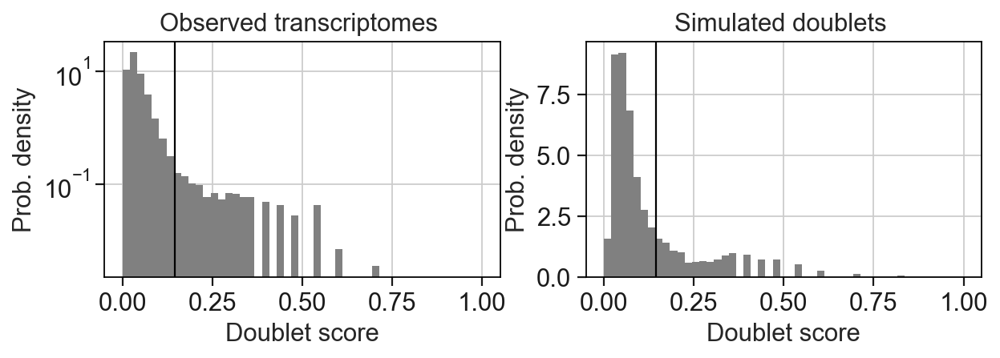

In [13]:
# check manual threshold
sc.external.pl.scrublet_score_distribution(Foxn1LacZ)

### Remove not expressed genes

In [14]:
# remove genes that are not expressed in any cells (remove columns with all 0s)
sc.pp.filter_genes(Foxn1LacZ, min_cells=1)

### Remove ribosomal protein genes

In [15]:
Foxn1LacZ = Foxn1LacZ[:,Foxn1LacZ.var['ribo']==False]
Foxn1LacZ.shape
Foxn1LacZ = Foxn1LacZ[:,Foxn1LacZ.var['hb']==False]
Foxn1LacZ.shape

(13981, 28320)

### Normalize for each cell's library size

In [16]:
sc.pp.normalize_per_cell(Foxn1LacZ, counts_per_cell_after=10**4)

### Log-transform counts

In [17]:
sc.pp.log1p(Foxn1LacZ)

## Select subset of principal components 

In [18]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1LacZ, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=False)

<function matplotlib.pyplot.show(close=None, block=None)>

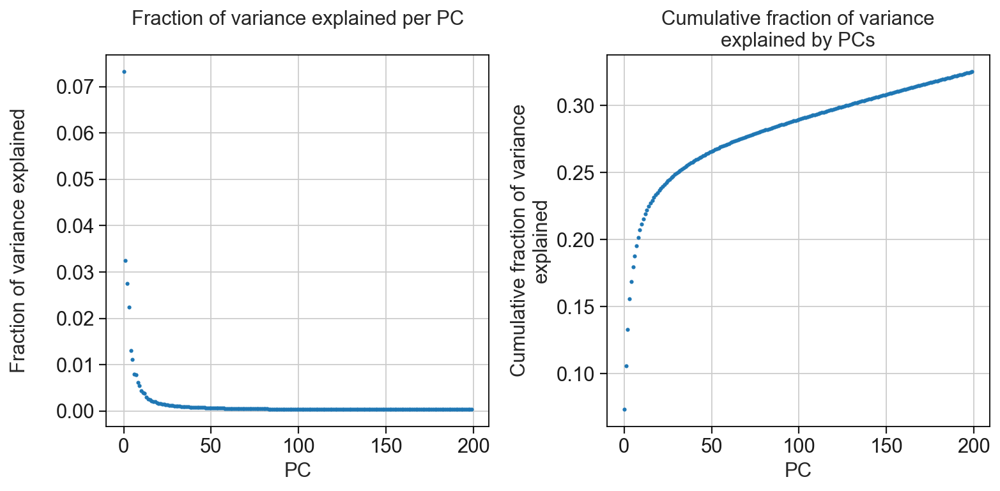

In [19]:
def observe_variance(anndata_object):
    fig = plt.figure(figsize=(10,5))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    # variance per principal component
    x = range(len(anndata_object.uns['pca']['variance_ratio']))
    y = anndata_object.uns['pca']['variance_ratio']
    ax1.scatter(x,y,s=4)
    ax1.set_xlabel('PC')
    ax1.set_ylabel('Fraction of variance explained\n')
    ax1.set_title('Fraction of variance explained per PC\n')
    # cumulative variance explained
    cml_var_explained = np.cumsum(anndata_object.uns['pca']['variance_ratio'])
    x = range(len(anndata_object.uns['pca']['variance_ratio']))
    y = cml_var_explained
    ax2.scatter(x,y,s=4)
    ax2.set_xlabel('PC')
    ax2.set_ylabel('Cumulative fraction of variance\nexplained')
    ax2.set_title('Cumulative fraction of variance\nexplained by PCs')
    fig.tight_layout()
    plot = plt.show
    return(plot)
observe_variance(Foxn1LacZ)

In [20]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1LacZ, n_comps=10,  svd_solver='arpack', random_state=rng, use_highly_variable=False)

In [21]:
sc.pp.neighbors(Foxn1LacZ, n_neighbors=15, random_state=42)

In [22]:
sc.tl.umap(Foxn1LacZ)

### Sample metadata

In [23]:
Foxn1LacZ.uns['sample_colors'] = user_defined_palette
Foxn1LacZ.uns['stage_colors'] = ['#BCD4E6']

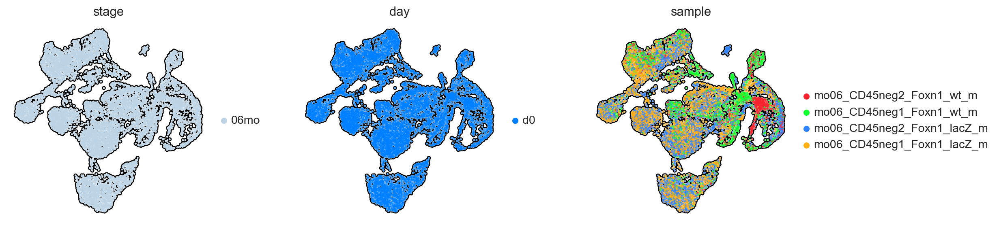

In [24]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ, 
    color=['stage', 'day', 'sample'], 
    color_map='Spectral_r', 
    use_raw=False,
    ncols=15,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

### QC metrics

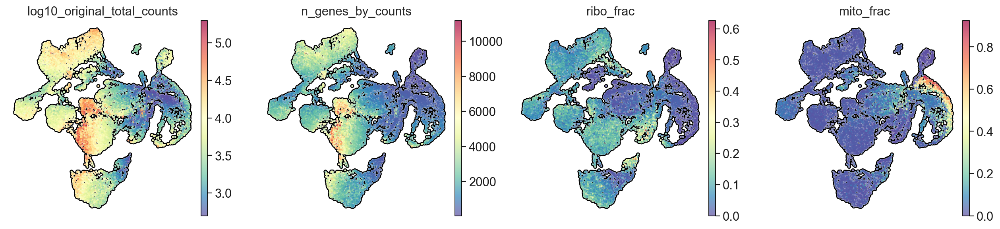

In [25]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ, 
    color=['log10_original_total_counts', 'n_genes_by_counts','ribo_frac', 'mito_frac'], 
    palette=user_defined_palette,  
    color_map='Spectral_r',
    use_raw=False,
    ncols=5,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

### Potential contaminant populations

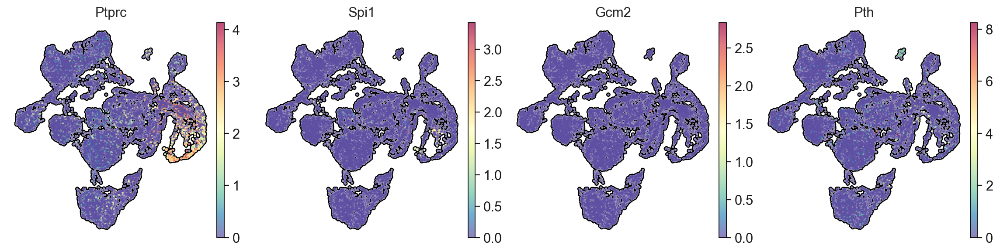

In [26]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ, 
    color=['Ptprc', 'Spi1', 'Gcm2', 'Pth'], 
    palette=user_defined_palette,  
    color_map='Spectral_r',
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

### Canonical markers

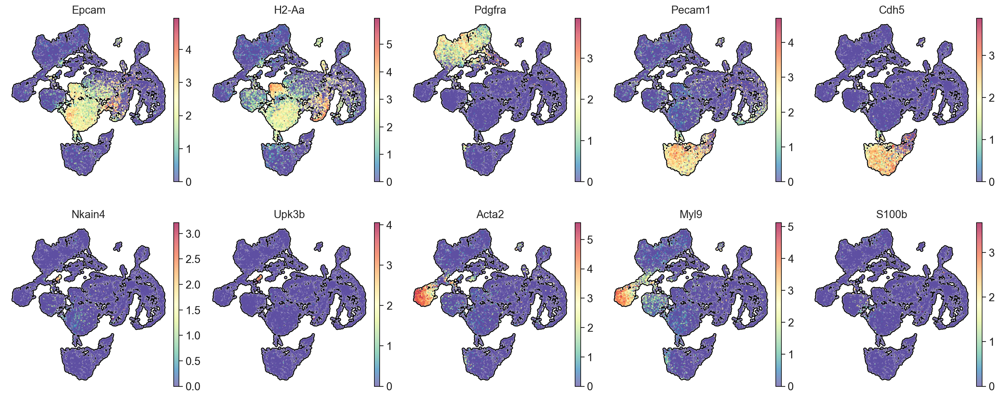

In [27]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ, 
    color=['Epcam', 'H2-Aa', 'Pdgfra', 'Pecam1', 'Cdh5', 'Nkain4', 'Upk3b', 'Acta2', 'Myl9', 'S100b'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [28]:
Foxn1LacZ_total = Foxn1LacZ

## Run unsupervised clustering analysis leiden

In [29]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(Foxn1LacZ, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

We can visualize the clustering to see which clusters match with the cells that we would like to filter out. Inspect the list of QC metrics and canonical markers to make your choice.

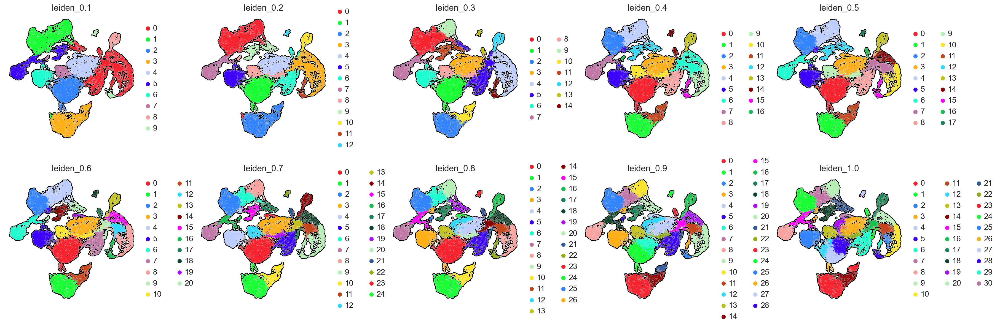

In [30]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5',
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

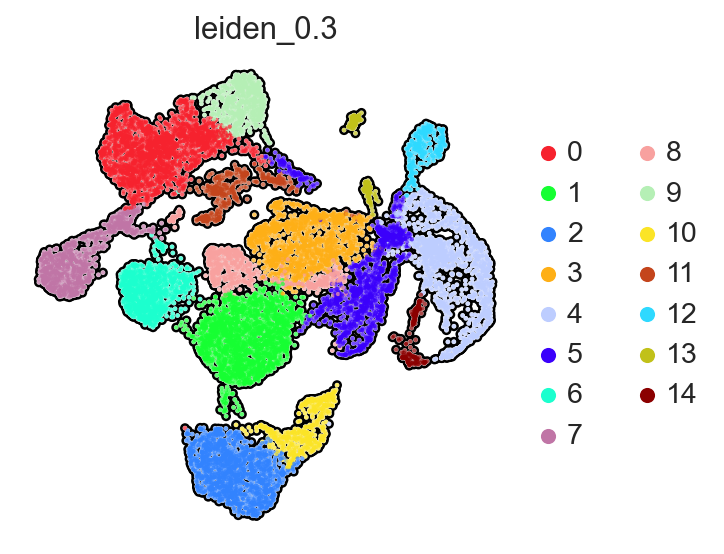

In [31]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ, 
    color=['leiden_0.3'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    size=15,
    wspace = 0.7,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

## Filter out bad quality cells by cluster

Choose which clusters you want to remove, and add them to the list clusters_to_remove below.

In [32]:
clusters_to_remove = ['3', '4', '5', '10', '11', '12', '13', '14']
cluster_filter = [x not in clusters_to_remove for x in Foxn1LacZ.obs['leiden_0.3']]
print('Total number of cells pre-filtering: ' + str(Foxn1LacZ.shape[0]))
print('Number of cells to keep after filtering: ' + str(sum(cluster_filter)))
Foxn1LacZ_filtered = Foxn1LacZ[cluster_filter]

Total number of cells pre-filtering: 13981
Number of cells to keep after filtering: 8613


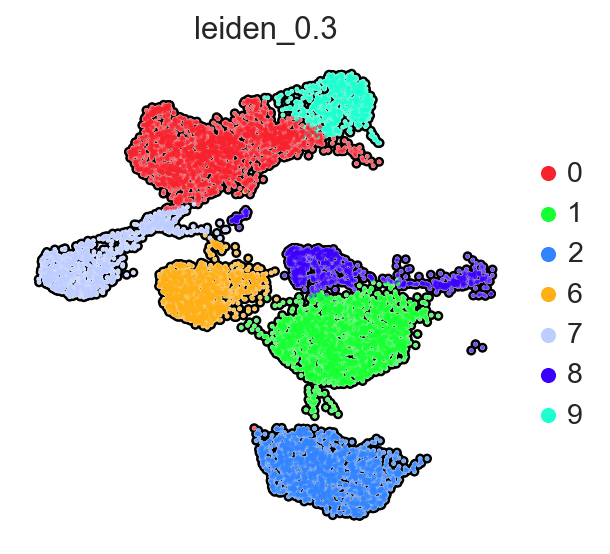

In [33]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ_filtered, 
    color=['leiden_0.3'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.5,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [34]:
Foxn1LacZ = Foxn1LacZ_filtered

In [35]:
Foxn1LacZ.shape

(8613, 28320)

## Filter out doublets and cell contaminants

This would be also a good spot to remove the doublets you have identified above or any other cell population that does not match your experimental strategy

In [36]:
Foxn1LacZ = Foxn1LacZ[Foxn1LacZ.obs['predicted_doublet'] == False]

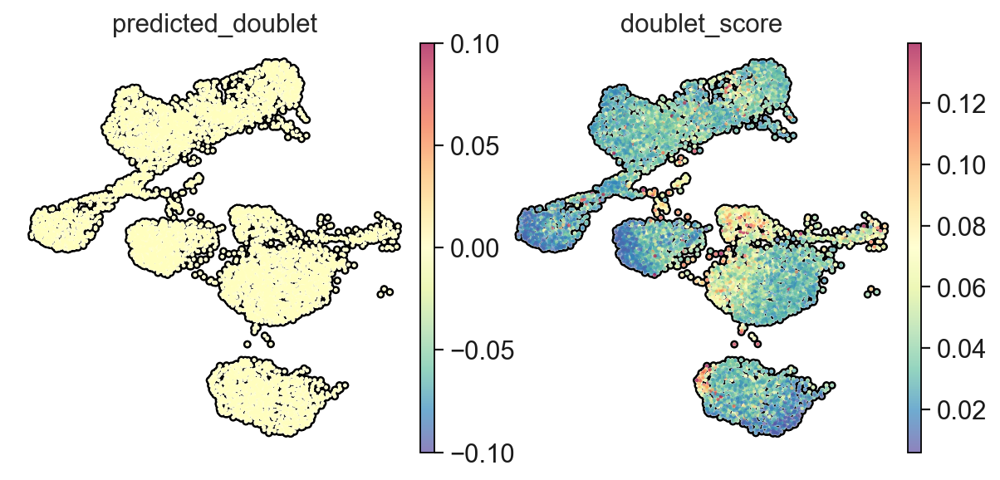

In [37]:
sc.pl.umap(
    Foxn1LacZ, 
    color=['predicted_doublet', 'doublet_score'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [38]:
Foxn1LacZ.obs['keep_cell'] = '0.yes'

In [39]:
keep_cells = pd.concat([Foxn1LacZ.obs['keep_cell']])

In [40]:
Foxn1LacZ_total.obs['keep_cell'] = '1.no'

In [41]:
Foxn1LacZ_total.obs['keep_cell'][Foxn1LacZ_total.obs.index.isin(keep_cells.index) == True] = '0.yes'

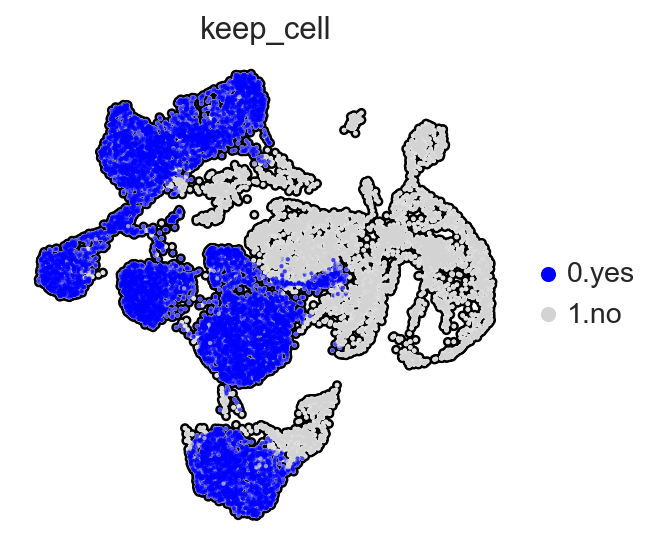

In [42]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    Foxn1LacZ_total, 
    color=['keep_cell'], 
    palette=['blue', '#d3d3d3'],  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [43]:
crosstb = pd.crosstab(Foxn1LacZ_total.obs['sample'], Foxn1LacZ_total.obs['keep_cell'])

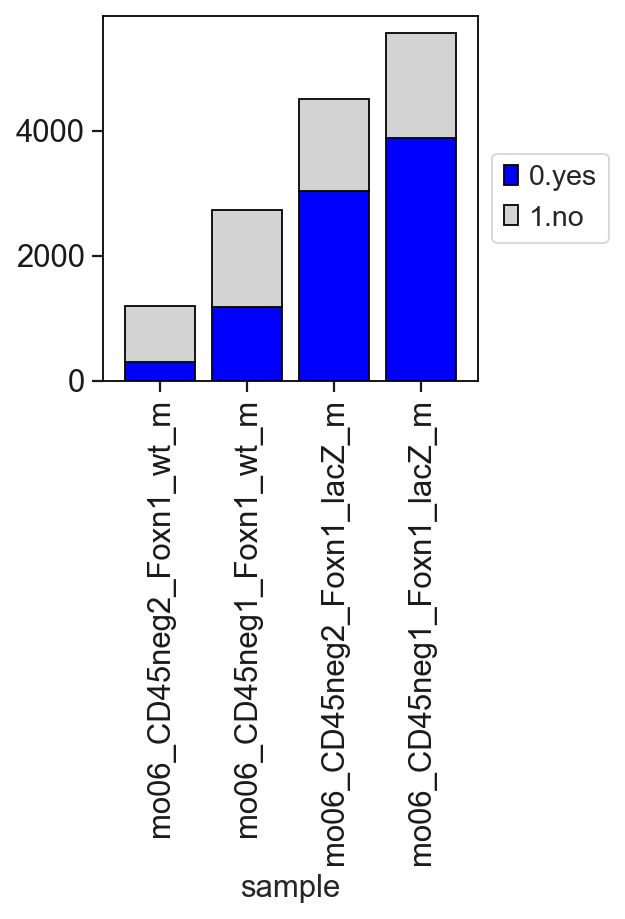

In [44]:
with rc_context({'figure.figsize': (3, 3)}):
    ax = crosstb.plot(kind="bar", stacked=True, edgecolor = "black", width=0.8,  color=['blue', '#d3d3d3'])
    ax.grid(False) 
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

Let's now inspect if the right number of doublet cells has been removed from the dataset.

In [45]:
Foxn1LacZ.shape

(8387, 28320)

## Data for Fig. 7h

In [53]:
sc.pp.highly_variable_genes(Foxn1LacZ, n_top_genes=3500, n_bins=20, flavor='seurat',  inplace=True)

In [54]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1LacZ, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=True)

<function matplotlib.pyplot.show(close=None, block=None)>

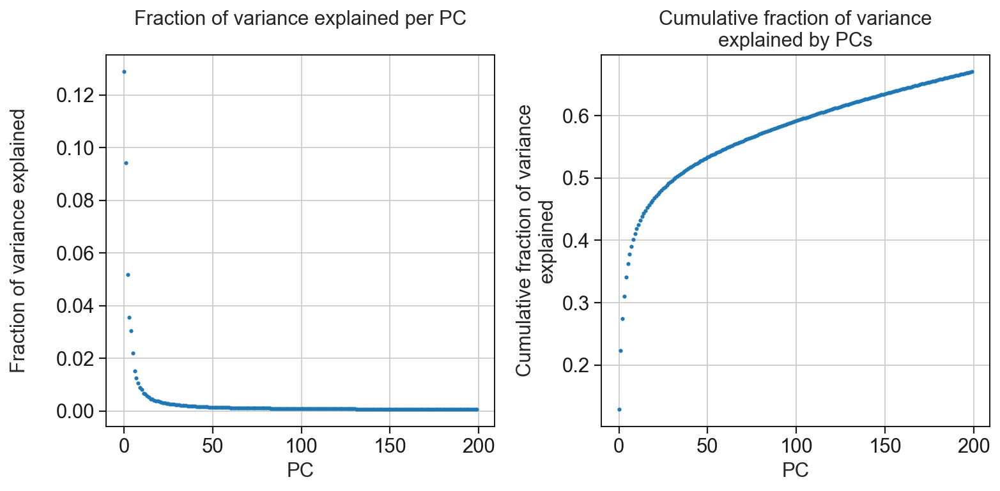

In [55]:
observe_variance(Foxn1LacZ)

In [56]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1LacZ, n_comps=35, svd_solver='arpack', random_state=rng, use_highly_variable=True)

In [57]:
sce.pp.harmony_integrate(Foxn1LacZ, 'sample')

2024-04-16 14:53:56,405 - harmonypy - INFO - Iteration 1 of 10
2024-04-16 14:53:57,314 - harmonypy - INFO - Iteration 2 of 10
2024-04-16 14:53:58,132 - harmonypy - INFO - Iteration 3 of 10
2024-04-16 14:53:58,999 - harmonypy - INFO - Converged after 3 iterations


In [58]:
sc.pp.neighbors(Foxn1LacZ, n_neighbors=15, use_rep='X_pca')
sc.tl.umap(Foxn1LacZ)

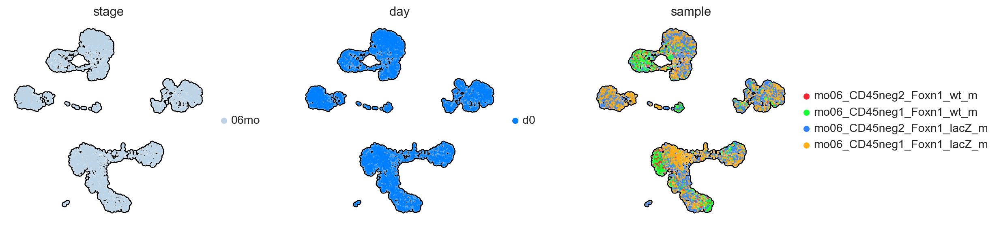

In [59]:
sc.pl.umap(Foxn1LacZ, color=['stage', 'day', 'sample'], 
                        color_map='Spectral_r',  use_raw=False, ncols=4, wspace = 0.3,
                        outline_width=[0.6, 0.05], size=15,  frameon=False, add_outline=True, sort_order = False)

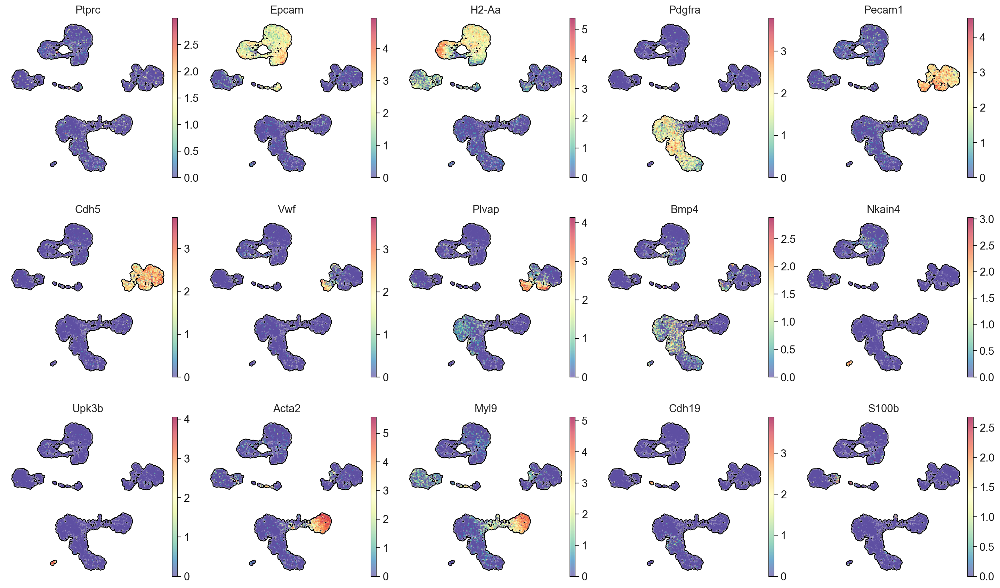

In [60]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ, 
    color=['Ptprc', 'Epcam', 'H2-Aa', 'Pdgfra', 'Pecam1',  'Cdh5', 'Vwf', 'Plvap', 'Bmp4', 'Nkain4', 'Upk3b', 'Acta2', 'Myl9', 'Cdh19', 'S100b'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [61]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(Foxn1LacZ, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

We can visualize the clustering to see which clusters match with the cells that we would like to filter out. Inspect the list of QC metrics and canonical markers to make your choice.

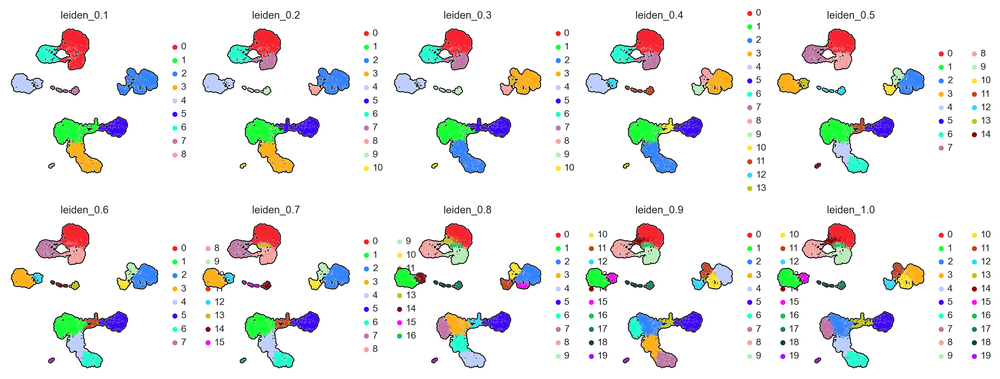

In [62]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1LacZ, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8','leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [63]:
artEC_sign = ['Fbln5',	'Stmn2',	'Clu',	'Sema3g',	'Glul',	'Tm4sf1',	'Eps8l2',	'Col8a1',	'Nebl',	'Vegfc',	'Alpl',	'Arl15',	'Gja4',	'Edn1',	'S100a6',	'Mast4',	'Sox17',	'Pdgfd',	'Fbln2',	'Vim']
capEC_sign = ['Gpihbp1',	'Rgcc',	'Fabp4',	'Cd36',	'Car4',	'Mgll',	'Cd300lg',	'Tcf15',	'Kdr',	'Arhgap18',	'Igfbp7',	'Kank3',	'Aqp7',	'Etl4',	'Tspan13',	'Cavin2',	'Hspb1',	'Ppp1r2',	'Lims2',	'Fabp5']
venEC_sign = ['Lrg1',	'Il6st',	'Vwf',	'Plvap',	'mt-Co1',	'Selp',	'Spint2',	'Pcdh7',	'mt-Nd4',	'2200002D01Rik',	'Tmsb10',	'Eef1a1',	'mt-Co3',	'Bgn',	'Pde4d',	'mt-Atp6',	'Aqp1',	'Tpt1',	'Ctla2a',	'Ackr1']

In [64]:
x=19
sc.tl.score_genes(Foxn1LacZ, gene_list = artEC_sign[0:x],  score_name='artEC_sign', use_raw=False)
sc.tl.score_genes(Foxn1LacZ, gene_list = capEC_sign[0:x],  score_name='capEC_sign', use_raw=False)
sc.tl.score_genes(Foxn1LacZ, gene_list = venEC_sign[0:x],  score_name='venEC_sign', use_raw=False)

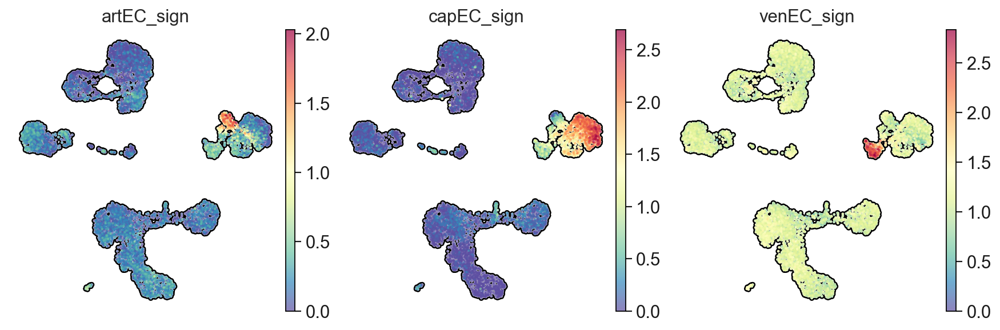

In [65]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    Foxn1LacZ,
    color=['artEC_sign', 'capEC_sign', 'venEC_sign'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    vmin=0    
)

In [66]:
capsFB_sign = ['Pi16',	'Timp2',	'Fn1',	'Opcml',	'Cd248',	'Mfap5',	'Anxa3',	'Pcolce2',	'Ackr3',	'Fndc1',	'Igfbp6',	'Sema3c',	'Clec3b',	'Creb5',	'Smpd3',	'Tmem100',	'Adgrd1',	'Ly6c1',	'Pcsk6',	'Nid1']
intFB_sign = ['Smoc2',	'Gpx3',	'Penk',	'Igf1',	'Gas1',	'Inmt',	'Pcolce',	'Lrp1',	'Itm2a',	'Gdf10',	'Rbp1',	'Fbln1',	'Sfrp1',	'Slit3',	'Svep1',	'Auts2',	'Lpl',	'Celf2',	'Serpinf1',	'Il11ra1']
medFB_sign = ['Csmd1',	'Serpine2',	'Enpp2',	'Ptn',	'Tmem176b',	'Tmem176a',	'B2m',	'Ccl19',	'Igfbp7',	'Apod',	'Bgn',	'H2-D1',	'Des',	'Ltc4s',	'Lhfp',	'Ifitm1',	'Cd9',	'Apoe',	'Lsamp',	'Ly6e']

In [67]:
x=19
sc.tl.score_genes(Foxn1LacZ, gene_list = capsFB_sign[0:x],  score_name='capsFB_sign', use_raw=False)
sc.tl.score_genes(Foxn1LacZ, gene_list = intFB_sign[0:x],  score_name='intFB_sign', use_raw=False)
sc.tl.score_genes(Foxn1LacZ, gene_list = medFB_sign[0:x],  score_name='medFB_sign', use_raw=False)

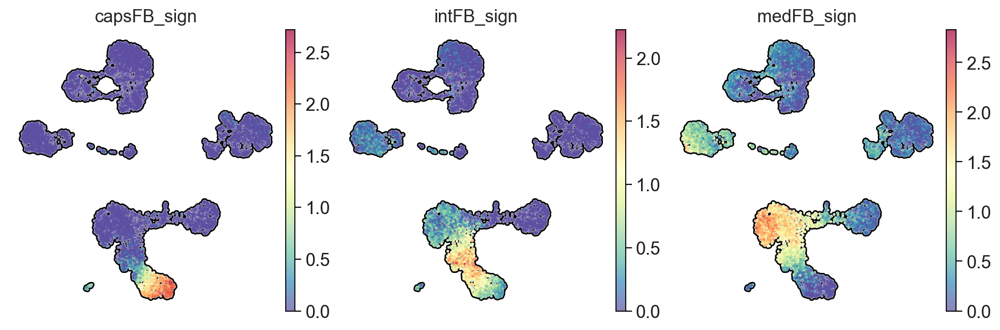

In [68]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    Foxn1LacZ,
    color=[ 'capsFB_sign', 'intFB_sign', 'medFB_sign'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False,
    vmin=0
)

### Create group annotation

In [69]:
Foxn1LacZ.obs['cell_type'] = ['FB' if (x=='1' or x=='4' or x=='6') else 
                          'EC' if (x=='2' or x=='9' or x=='10') else
                          'TEC' if (x=='0' or x=='3' or x=='7' or x=='8' or x=='12' or x=='13' or x=='14' or x=='15') else 
                          '6:MEC' if x=='16' else
                          '7:vSMC/PC' if (x=='5' or x=='11') else 'ERROR' for x in Foxn1LacZ.obs['leiden_0.7']] 

In [70]:
Foxn1LacZ.uns['cell_type_colors'] = ['#d62728','#19c9b3', '#ff7f0e','#199919', '#aa40fc']

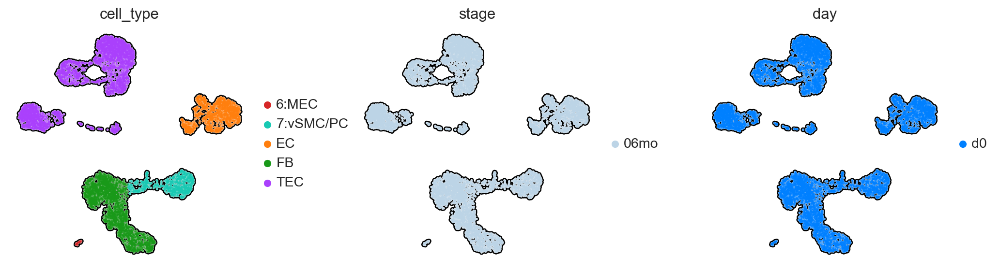

In [71]:
sc.pl.umap(Foxn1LacZ, color=['cell_type', 'stage', 'day'], 
                        color_map='Spectral_r',  use_raw=False, ncols=4, wspace = 0.3,
                        outline_width=[0.6, 0.05], size=15,  frameon=False, add_outline=True, sort_order = False)

In [72]:
Foxn1LacZ.obs['cell_type_subset'] = ['3:capsFB' if (x=='6') else '4:intFB' if (x=='4') else '5:medFB' if (x=='1') else
                                 '0:arEC' if (x=='9') else  '1:capEC' if (x=='2') else  '2:venEC' if (x=='10') else
                                 'TEC' if (x=='0' or x=='3' or x=='7' or x=='8' or x=='12' or x=='13' or x=='14' or x=='15') else 
                                 '6:MEC' if x=='16' else
                                 '7:vSMC/PC' if (x=='5' or x=='11') else 'ERROR' for x in Foxn1LacZ.obs['leiden_0.7']] 

In [73]:
Foxn1LacZ.uns['cell_type_subset_colors'] = user_defined_palette

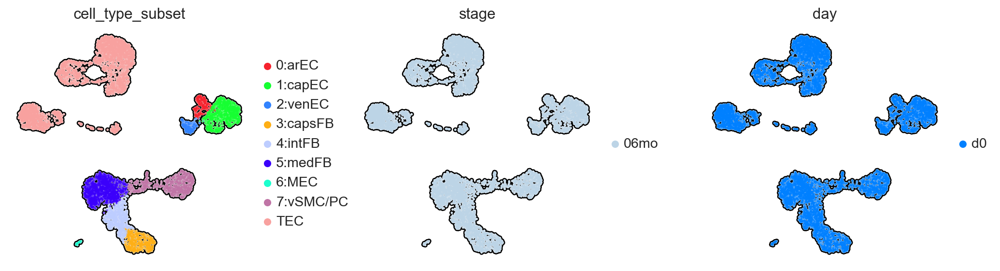

In [75]:
sc.pl.umap(Foxn1LacZ, color=['cell_type_subset', 'stage', 'day'], 
                        color_map='Spectral_r',  use_raw=False, ncols=4, wspace = 0.3,
                        outline_width=[0.6, 0.05], size=15,  frameon=False, add_outline=True, sort_order = False)

## Re-analyze TEC 

In [76]:
TEC_Foxn1LacZ = Foxn1LacZ[(Foxn1LacZ.obs['cell_type']=='TEC')]

In [77]:
# Remove columns with all 0s
sc.pp.filter_genes(TEC_Foxn1LacZ, min_cells=1)

In [78]:
sc.pp.highly_variable_genes(TEC_Foxn1LacZ, n_top_genes=3500, n_bins=20, flavor='seurat')

In [79]:
rng = np.random.RandomState(42)
sc.tl.pca(TEC_Foxn1LacZ, n_comps=45, svd_solver='arpack', random_state=rng, use_highly_variable=True)

In [80]:
sc.pp.neighbors(TEC_Foxn1LacZ, n_neighbors=15, use_rep='X_pca')
sc.tl.umap(TEC_Foxn1LacZ)

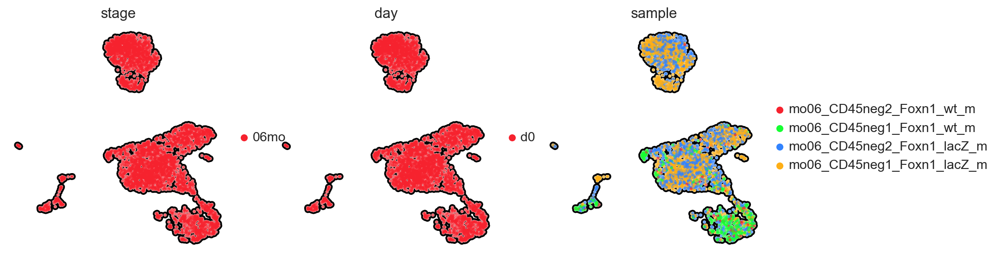

In [81]:
#35
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    TEC_Foxn1LacZ, 
    color=['stage', 'day', 'sample'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

### TEC signatures at steady state

In [82]:
aaTEC1_sign = ['Zbtb20',	'Cd81',	'Trpm3',	'Gstm1',	'Slc16a11',	'Btg1',	'BC006965',	'Cldn3',	'Gsta4',	'S100a11',	'Ly6e',	'Cdk19',	'Slc9a3r1',	'Ifi27l2a',	'Aldoc',	'Wfdc18',	'Phlda1',	'Fam107a',	'Gsn',	'Anxa2']
aaTEC2_sign = ['Csmd1',	'Zeb2',	'Mgp',	'Gsn',	'Zbtb20',	'Ndrg2',	'Serpine2',	'Cd81',	'Fxyd1',	'Laptm4a',	'Gpx3',	'Socs3',	'Igfbp7',	'Airn',	'Lgals1',	'Fos',	'Prrx1',	'Prkg1',	'Sparc',	'Junb']
cTEC_sign = ['Ctsl',	'Cstb',	'Cxcl12',	'Prss16',	'Krt18',	'Gas6',	'Pltp',	'Slc46a2',	'Ndufa11',	'Tbata',	'Ccl25',	'Psmb11',	'Tmem131l',	'Nlgn1',	'Prxl2b',	'Pax1',	'Wnt4',	'Dpp6',	'Psmb9',	'Bnip3l']
early_Pr = ['Apoe',	'Itm2b',	'Dcn',	'Gas6',	'Gas1',	'Rbms3',	'Laptm4a',	'Ctsl',	'Cpne8',	'Mir100hg',	'Gas5',	'Cst3',	'Ly6a',	'Ifitm3',	'Kazald1',	'Mir99ahg',	'Ifitm2',	'Plpp3',	'Oat',	'Auts2']
mTEC1_sign = ['Ccl21a',	'Krt14',	'Krt5',	'Ifitm3',	'Apoe',	'Tpm2',	'Cald1',	'Ifi27l2a',	'Ifitm2',	'Krt17',	'Nxn',	'Ctsl',	'Eya4',	'Rbms3',	'Perp',	'Ly6a',	'Igfbp4',	'Sult5a1',	'Map1lc3a',	'Ank3']
mTECprol_sign = ['H2afz',	'Stmn1',	'Ran',	'Eif5a',	'Hmgb2',	'Ube2s',	'Ybx1',	'Phgdh',	'Ptma',	'Selenoh',	'Ppia',	'Tubb5',	'Nme1',	'Pfn1',	'Ranbp1',	'Hmgn2',	'Hnrnpa1',	'Rbm3',	'Cks1b',	'Banf1']
mTEC2_sign = ['Srgn',	'Ubd',	'Cd52',	'Cyba',	'Cd74',	'H2-Aa',	'Syt1',	'Csn2',	'H2-Eb1',	'S100a14',	'H2-Oa',	'H2-Eb2',	'Hdc',	'Mrpl38',	'Nfkbia',	'Gm48239',	'Aire',	'Nup85',	'Hagh',	'Calcb']
basal_sign = ['Ly6d',	'Dmkn',	'Spink5',	'Fxyd3',	'Skint3',	'Dapl1',	'Hspb1',	'Sfn',	'Tacstd2',	'Pdzk1ip1',	'Prdx5',	'Oit1',	'Cdkn2a',	'Perp',	'Cdkn1a',	'Cdkn2b',	'Gsta4',	'Atox1',	'Lypd3',	'Cst6']
tuft_sign = ['Mctp1',	'Gng13',	'Avil',	'Rgs13',	'Espn',	'Lrmp',	'Anxa4',	'Ltc4s',	'Ptpn18',	'Bmx',	'Cystm1',	'Ivns1abp',	'Fyb',	'Ly6g6f',	'Calm2',	'Ethe1',	'Reep5',	'Lima1',	'1810046K07Rik',	'Abhd2']
nTEC_sign = ['Ptprn2',	'Cacna2d1',	'Car8',	'Scg5',	'Stxbp5l',	'Snap25',	'Chga',	'Cd9',	'Dnajc12',	'Ccser1',	'Pam',	'Camk2n1',	'Syt7',	'Cacna1a',	'Syt1',	'Cacnb2',	'Cystm1',	'Fam183b',	'Cplx2',	'Ceacam10']
goblet_sign = ['Wfdc2',	'Cyp2f2',	'Cxcl17',	'Gsto1',	'S100a11',	'Nupr1',	'Sorbs2',	'Anxa3',	'H2-K1',	'Krt19',	'Fxyd3',	'Ly6d',	'Ly6e',	'Serpinb11',	'Slc12a2',	'Anxa1',	'Ly6a',	'Bace2',	'Aqp5',	'Atp1b1']
Mlike_sign  = ['Ccl20',	'Ccl9',	'Serpinb6a',	'Serpinb1a',	'Tmsb4x',	'2200002D01Rik',	'Nostrin',	'Ctsh',	'Ccl6',	'AW112010',	'Spib',	'Bcl2a1d',	'Csn2',	'Cyp2a5',	'Fabp1',	'Hamp',	'Pold1',	'Bcl2a1b',	'Atox1',	'Iscu']

In [83]:
x=19
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = aaTEC1_sign[0:x],  score_name='aaTEC1_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = aaTEC2_sign[0:x],  score_name='aaTEC2_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = cTEC_sign[0:x],  score_name='cTEC_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = early_Pr[0:x],  score_name='early_Pr', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = mTEC1_sign[0:x],  score_name='mTEC1_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = mTECprol_sign[0:x],  score_name='mTECprol_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = mTEC2_sign[0:x],  score_name='mTEC2_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = basal_sign[0:x],  score_name='basal_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = tuft_sign[0:x],  score_name='tuft_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = nTEC_sign[0:x],  score_name='nTEC_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = goblet_sign[0:x],  score_name='goblet_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, gene_list = Mlike_sign[0:x],  score_name='Mlike_sign', use_raw=False)

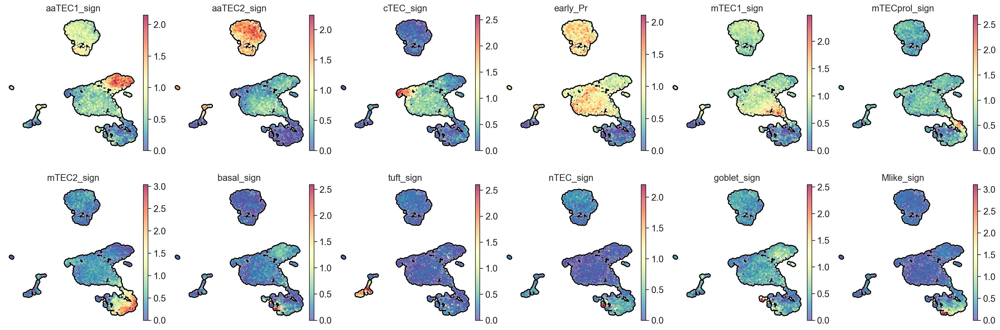

In [84]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_Foxn1LacZ,
    color=['aaTEC1_sign', 'aaTEC2_sign', 'cTEC_sign', 'early_Pr', 'mTEC1_sign', 'mTECprol_sign', 'mTEC2_sign', 
          'basal_sign', 'tuft_sign', 'nTEC_sign', 'goblet_sign','Mlike_sign'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=6,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    vmin=0
)

In [85]:
for resolution_parameter in [1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2.0]:
    sc.tl.leiden(TEC_Foxn1LacZ, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

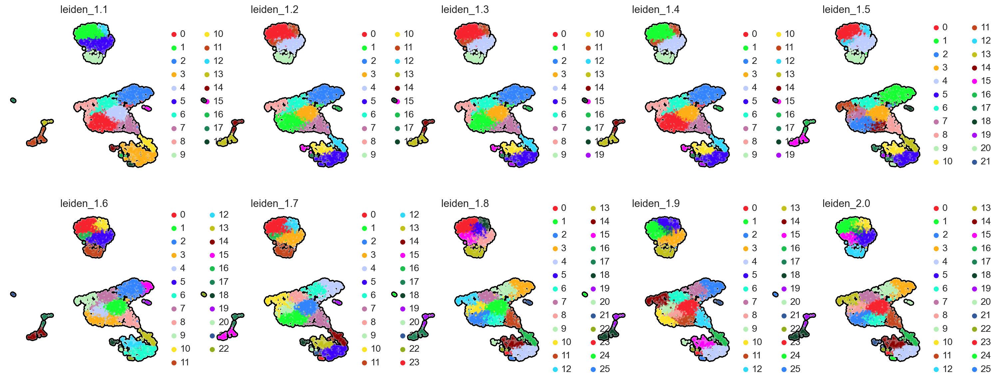

In [87]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    TEC_Foxn1LacZ, 
    color=['leiden_1.1', 'leiden_1.2', 'leiden_1.3', 'leiden_1.4', 'leiden_1.5', 
           'leiden_1.6', 'leiden_1.7', 'leiden_1.8','leiden_1.9', 'leiden_2.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [88]:
early_progenitor_genes = ['Ackr4',	'Adamts10',	'Agrn',	'Aldh2',	'Aldh6a1',	'Amotl1',	'Amotl2',	'Antxr1',	'Apoe',	'Ar',	'Bcam',	'Bcl11a',	'Bcl2',	'Bmp4',	'Btg2',	'Cbx6',	'Ccdc80',	'Cdh11',	'Cldn8',	'Clec11a',	'Clstn1',	'Col18a1',	'Cpne8',	'Cthrc1',	'Cyp1b1',	'Dcn',	'Ddr1',	'Dhrs3',	'Dlk2',	'Dnajc13',	'Dpp6',	'Dpysl2',	'Dsc3',	'Egr1',	'Eid1',	'Fam129a',	'Fam19a5',	'Fkbp9',	'Fmod',	'Fos',	'Fosb',	'Frmd6',	'Fstl1',	'Ogn',	'Gas1',	'Pak3',	'Gbp2',	'Palld',	'Gnaq',	'Pdpn',	'Gpm6b',	'Penk',	'Gprasp1',	'Plxdc2',	'Gstm2',	'Pmp22',	'H2-Dma',	'Prelp',	'Hes6',	'Prrg3',	'Hic1',	'Prss23',	'Hsd17b10',	'Ptprz1',	'Igfbp2',	'Ptrf',	'Igfbp3',	'Pygb',	'Igfbp5',	'Rbp1',	'Igfbp7',	'Rnase4',	'Iigp1',	'Scn1a',	'Il33',	'Serpinf1',	'Irgm1',	'Serpinh1',	'Isl1',	'Shisa2',	'Itm2c',	'Slc2a13',	'Kazald1',	'Sord',	'Lamb1',	'Sparc',	'Laptm4a',	'Spon2',	'Limch1',	'Spry1',	'Ltbp3',	'Tcn2',	'Maged1',	'Tgfbr2',	'Megf6',	'Tgfbr3',	'Meis1',	'Thbd',	'Mgll',	'Thbs1',	'Mgp',	'Timp2',	'Myl9',	'Tinagl1',	'Mylk',	'Tnfrsf19',	'Nbl1',	'Tns1',	'Nell2',	'Tns3',	'Nfia',	'Trim29',	'Nfib',	'Trp63',	'Nfix',	'Tspan9',	'Nr2f1',	'Twsg1',	'Nr4a1',	'Txnip',	'Nrtn',	'Unc119',	'Ntrk3',	'Vmac',	'Oat',	'Wls',	'Wscd1',	'Xdh',	'Zfp36']
postnatal_progenitor_genes = ['Acta2',	'Apoe',	'Ascl1',	'Boc',	'C1s1',	'C3',	'Cald1',	'Ccl11',	'Ccl21a',	'Clca3a1',	'Col6a1',	'Col6a2',	'Cyr61',	'Ddx60',	'Dpysl3',	'Dst',	'Emp2',	'Fam101b',	'Flna',	'Fst',	'Fzd2',	'Gas1',	'Glul',	'Gpx3',	'Gsn',	'Hpgd',	'Htra1',	'Id1',	'Ifi27l2a',	'Igfbp4',	'Igfbp5',	'Irf7',	'Isg15',	'Itga6',	'Itgb4',	'Krt14',	'Krt5',	'Krt7',	'Lamb3',	'Lars2',	'Lifr',	'Mgp',	'Myl9',	'Nrbp2',	'S1pr3',	'Slc4a11',	'Sox4',	'Stat2',	'Sult5a1',	'Tagln',	'Tgfbi',	'Tpm2',	'Wfikkn2']

In [89]:
sc.tl.score_genes(TEC_Foxn1LacZ, early_progenitor_genes, score_name='early progenitor\nsignature', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, postnatal_progenitor_genes, score_name='postnatal progenitor\nsignature', use_raw=False)

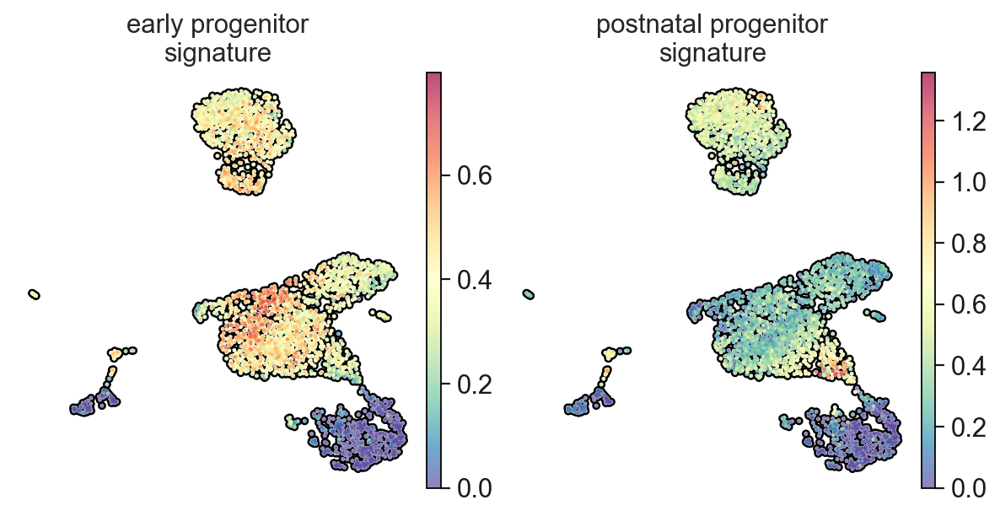

In [90]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_Foxn1LacZ,
    color=['early progenitor\nsignature', 'postnatal progenitor\nsignature'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=9,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    vmin=0
)

In [91]:
per_cTEC = ['Prss16',	'Ctsl',	'Fabp5',	'Cxcl12',	'Cstb',	'Pltp',	'Psmb11',	'Hes6',	'Pax1',	'Crip3',	'Castor1',	'Nqo1',	'Mdk',	'1810058I24Rik',	'Ndufa11',	'Kcnk2']
adult_cTEC = ['Prss16',	'Tbata',	'Ccl25',	'Ctsl',	'Psmb11',	'Cxcl12',	'Fxyd2',	'Cstb',	'Crip3',	'Ly75',	'Isg20',	'Tmem131l',	'Prxl2b',	'Synm',	'Pax1',	'Cd83',	'Pltp',	'Ndrg3',	'Fn1',	'Gas6',	'Sgpl1']
transit_ampl = ['Hmgb2',	'Hist1h2ap',	'Stmn1',	'H2az1',	'Mki67',	'Top2a',	'Cenpf',	'Ran',	'Cks2']
immature = ['Ccl21a',	'Gm8113',	'Krt14',	'Krt5',	'Tagln',	'Col6a1',	'Fcgbp',	'Lifr',	'Flna',	'Rgs5']
aire = ['Srgn',	'S100a8',	'Ccl5',	'Cd52',	'Ubd',	'S100a9',	'H2-Aa',	'S100a14',	'Cd74',	'Aire',	'Csn2',	'Cxcl9',	'H2-Eb1',	'Cyba',	'Nts',	'H2-Ab1',	'Pyy',	'Ifi30',	'Calcb',	'Hdc',	'Lyz2']
enteropato = ['Saa3',	'Lypd8',	'Spink1',	'Saa1',	'Ttr',	'Reg3b',	'Reg3g',	'Prap1',	'Apoc3',	'Aldob',	'Reg1',	'Pigr',	'Lgals4',	'Clca1',	'Apoa4',	'Tff3',	'S100g',	'Klk1b26',	'2210407C18Rik',	'Cd52',	'Muc13',	'Apoa1',	'AW112010',	'Fabp9']
microfold = ['Ccl20',	'Pglyrp1',	'Serpinb6a',	'Hamp',	'Ccl6',	'Serpinb1a',	'Ccl9',	'Wfdc17',	'Lyz1',	'Rnase1',	'Fabp1',	'Gp2',	'Tnfaip2',	'Msln',	'Cyp2a5',	'Wfdc18',	'Csn2',	'2200002D01Rik',	'Reg3g',	'Ctsh',	'Prg2',	'Gucy1b2',	'Tnfrsf11b',	'Cr2',	'Gjb2',	'Clu',	'Bcl2a1b',	'AW112010',	'H2-M2',	'Fabp5',	'Apoa1',	'Tmsb4x',	'Krt20',	'Spink4',	'Apoa4',	'Nostrin',	'Gpx1',	'Anxa5',	'Spib',	'Plb1',	'Abca13',	'Gm50069',	'Sncg',	'Sox8',	'Bcl2a1a',	'Iapp',	'Bcl2a1d',	'Atp6v1c1',	'Ubd']
neuroendocrine = ['Clca3b',	'Klk1',	'Cd177',	'Resp18',	'Chgb',	'Cacna2d1',	'Chga',	'Ceacam10',	'Rbp4',	'Cd9',	'Iglc3',	'Iapp',	'Ghrl',	'Fam183b',	'Scg2',	'Scg5',	'Itln1',	'Krt7',	'Insm1',	'Fmo3',	'Fmo2',	'Cplx2',	'AW112010']
ptf1a_pancreatic = ['Prss2',	'Clps',	'Spink1',	'Reg1',	'Klk1',	'Ptf1a',	'Chga',	'AW112010',	'Gp2',	'Try5',	'Nupr1',	'Reg3g',	'Fetub',	'Pigr',	'Car8',	'Ceacam10']
muscle = ['Cdkn1c',	'Meg3',	'Mylpf',	'Acta1',	'Myog',	'Myl1',	'Actc1',	'Sln',	'Ckb',	'Ckm',	'Ttn',	'C430049B03Rik',	'Spg21',	'Mymx',	'Ppp1r14b',	'Dlk1',	'Neb',	'5430431A17Rik',	'Hes6',	'Rian',	'Tnnc2',	'Des',	'Lsm6',	'Arl6ip5',	'Rbm24']
tuft1 = ['Fyb',	'Dclk1',	'Ptpn18',	'Atp1a2',	'Sh2d6',	'Plcb2',	'Nrgn',	'Trpm5',	'Agt',	'Ahnak2',	'Ly6g6f']
tuft2 = ['Gnat3',	'Gnb3',	'Plac8',	'Gng13',	'Lrmp',	'Rgs13',	'Cited2',	'Krt19',	'Ethe1',	'Fxyd6',	'Cystm1']
goblet = ['Ltf',	'Wfdc2',	'Gsto1',	'Ecm1',	'Bpifa1',	'Anxa1',	'Lcn2',	'Nupr1',	'Trf',	'Gsta4',	'Serpinb11',	'Pigr',	'Ly6d',	'Scgb3a2',	'Spink5',	'Ifitm1',	'Cxcl17',	'Serpinb2',	'Psca',	'Ly6a',	'Krt6a',	'Krt6b',	'Prss27',	'Scgb3a1',	'Hspb1',	'S100a6',	'Sftpd',	'Cxcl5',	'Cyp2f2',	'Sat1',	'Fxyd3',	'Cbr2',	'Clu',	'Aqp4',	'Cnfn',	'Rptn',	'Plet1',	'Lgals3']
ionocyte = ['Slc12a2',	'Atp6v1g3',	'Iapp',	'Slc4a11',	'S100a6',	'Ascl3',	'Foxi1',	'Gm47662',	'Pam',	'Serpinb9',	'Rnase4',	'Umod',	'Tfcp2l1',	'Wfdc2',	'Cftr',	'Atp6v1b1',	'Atp1a1',	'Cxcl17',	'Nupr1',	'Cd24a']
ciliated = ['Tppp3',	'Ccdc153',	'Dynlrb2',	'Fam183b',	'Ly6c1',	'Tubb4b',	'Tmem212',	'Lcn2',	'Meig1',	'Lrrc23',	'S100a6',	'Elof1',	'Riiad1',	'1110017D15Rik',	'Foxj1',	'Hsp90aa1',	'Rsph1',	'Mt1',	'Nudc',	'Ifitm1',	'AU040972',	'Chchd10',	'Vpreb3',	'1700016K19Rik',	'Tmem107',	'Mlf1',	'Nudt4',	'Hdc',	'Cfap298',	'Lrrc51',	'Hp',	'Ccdc39',	'Ly6a',	'Cacna1s',	'Tm4sf1',	'Pifo',	'Gm867',	'Fam166c',	'Tekt1',	'Cfap126',	'Gm19935',	'Dnah12',	'Wfdc2',	'BC051019',	'4833427G06Rik',	'Arhgdig',	'Crip1',	'Cep83',	'Sntn',	'Plet1',	'Ccdc34',	'Ccdc17',	'Cfap44',	'Spef2',	'Ccdc30',	'Crip2',	'3300002A11Rik',	'Spaca9',	'Cdkn1c',	'Ruvbl2',	'Enkur',	'Bst2',	'Nme5',	'Spag17',	'Ccdc78',	'Dnah6',	'Ccdc189',	'Lrriq1',	'Cp',	'Nme9']
lung_basal = ['Bpifa1',	'Wfdc2',	'Spink5',	'S100g',	'Rptn',	'Upk3a',	'Reg3g',	'Spink1',	'Gsta4',	'Tff1',	'Cyp2a5',	'Nupr1',	'Ly6d',	'Cyp2f2',	'Gm2a',	'Dapl1',	'Serpinb11',	'Serpinb2',	'Oit1',	'Scgb1a1',	'Gm94']
skin_basal = ['Krt10',	'Lgals7',	'Krtdap',	'Defb6',	'Gm94',	'Dapl1',	'Krt1',	'Dmkn',	'Calm4',	'Krt77',	'Krt16',	'Ly6d',	'Tmem45a',	'Fam25c',	'Ly6g6c',	'Calml3',	'Spink5',	'Lypd3',	'Gltp',	'Gsta4',	'Krt79',	'Sfn',	'Sbsn',	'Wfdc21',	'Skint3',	'Krt17',	'Perp',	'Sprr1a',	'Cst6',	'Slurp1',	'Serpinb2',	'Pdzk1ip1',	'Ear1',	'Flg',	'Hspb1',	'Clca3a2']
skin_kerat = ['Cst6',	'Flg',	'Calm4',	'Krtdap',	'Asprv1',	'Crct1',	'Lor',	'Klk7',	'Sprr1a',	'Dmkn',	'Cnfn',	'Sbsn',	'2310046K23Rik',	'Spink5',	'Krt16',	'Fam25c',	'Wfdc21',	'Hrnr',	'Dapl1',	'Il1f6',	'Gm94',	'Krt77',	'Psapl1',	'Chil1',	'Defb6',	'Gan',	'Calml3',	'Krt10',	'Ly6g6c',	'Scgb1a1',	'Acpp',	'Nccrp1',	'Rptn',	'S100a9',	'Krt23',	'Klk6',	'Krt79',	'Elovl4',	'Pdzk1ip1',	'Spink12',	'Slurp1',	'Glrx',	'Tmem45a',	'Nupr1',	'Il1f5',	'Ly6d',	'Krt17',	'Cdsn',	'Hspb1',	'Klk13',	'Ivl',	'Lypd5',	'Sprr2d',	'Lypd3',	'Clic3',	'Ide',	'Cebpb',	'Csta1',	'Tacstd2',	'Flg2',	'Ctsd',	'Endou',	'Krt80',	'Ybx3',	'Cyp2b19',	'Hal',	'Psors1c2',	'Perp',	'Cysrt1',	'Cdkn1a',	'Prdx5',	'Efna3',	'Orm1']

In [92]:
sc.tl.score_genes(TEC_Foxn1LacZ, per_cTEC, score_name='per_cTEC', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, adult_cTEC, score_name='adult_cTEC', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, transit_ampl, score_name='transit_ampl', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, immature, score_name='immature', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, aire, score_name='aire', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, enteropato, score_name='enteropato', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, microfold, score_name='microfold', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, neuroendocrine, score_name='neuroendocrine', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, ptf1a_pancreatic, score_name='ptf1a_pancreatic', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, muscle, score_name='muscle', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, tuft1, score_name='tuft1', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, tuft2, score_name='tuft2', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, goblet, score_name='goblet', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, ionocyte, score_name='ionocyte', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, ciliated, score_name='ciliated', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, lung_basal, score_name='lung_basal', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, skin_basal, score_name='skin_basal', use_raw=False)
sc.tl.score_genes(TEC_Foxn1LacZ, skin_kerat, score_name='skin_kerat', use_raw=False)

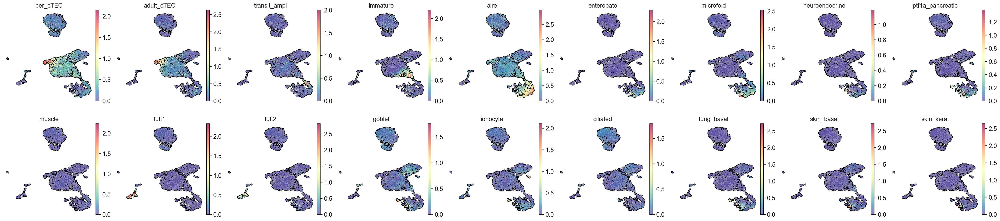

In [93]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_Foxn1LacZ, 
    color=['per_cTEC', 'adult_cTEC', 'transit_ampl', 'immature', 'aire', 'enteropato', 'microfold',
           'neuroendocrine', 'ptf1a_pancreatic', 'muscle', 'tuft1', 'tuft2', 'goblet', 'ionocyte', 'ciliated', 
          'lung_basal', 'skin_basal', 'skin_kerat'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=9,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False,
    vmin=0
)

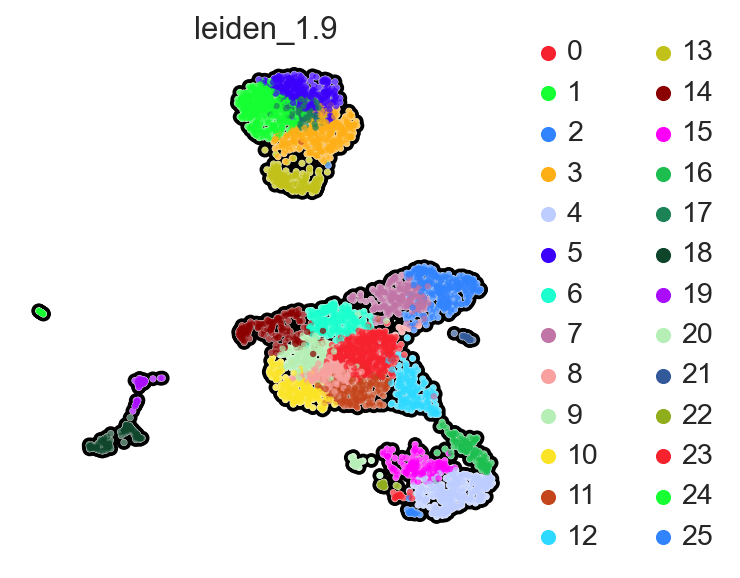

In [94]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    TEC_Foxn1LacZ, 
    color=['leiden_1.9'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [95]:
TEC_Foxn1LacZ.obs['cell_type_subset'] = ['11:aaTEC2' if (x=='1' or x=='3' or x=='5' or x=='13' or x=='17') else '10:aaTEC1' if (x=='2' or x=='7') else '12:early Pr' if (x=='6' or x=='9' or x=='8' or x=='0' or x=='10' or x=='11' ) else
                                 '12:cTEC' if (x=='14') else '13:mTEC1' if ( x=='12') else 
                                 '14:mTEC-prol' if x=='16' else '15:mTEC2' if (x=='4' or x=='15') else
                                 '16:mimetic(basal)' if ( x=='23') else '17:mimetic(tuft)' if (x=='18' or x=='19') else '18:mimetic(neuroendo)' if x=='22' else
                                 '19:mimetic(goblet)' if x=='20' else '20:mimetic(microfold)' if x=='25' else '21:mimetic(ionocyte)' if x=='21' else
                                 '8:nmSC' if x=='24' else 'ERROR' for x in TEC_Foxn1LacZ.obs['leiden_1.9']] 

In [96]:
TEC_Foxn1LacZ.uns['cell_type_subset_colors'] = ['#FFA5D2', '#2ED9FF', '#c1c119',  '#8b0000','#3B00FB', '#FE00FA', "#F8A19F", '#1CBE4F','#B5EFB5', '#BEFFF7' ,'#FEAF16', '#325A9B', '#C075A6', 'black', 'grey']

In [97]:
TEC_Foxn1LacZ.obs['dataset'] = ['Foxn1_wt' if 'wt' in x else 'Foxn1_lacZ' if 'lac' in x else 'ERROR' for x in TEC_Foxn1LacZ.obs['sample']]

In [98]:
TEC_Foxn1LacZ.uns['dataset_colors'] = [ 
 '#3283FE', '#d3d3d3']

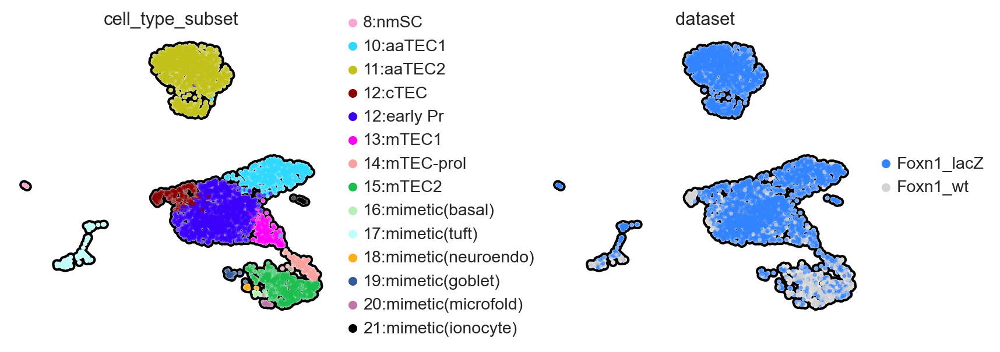

In [99]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    TEC_Foxn1LacZ, 
    color=['cell_type_subset', 'dataset' ], 
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    size=40,
    wspace = 0.5,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True
)

In [102]:
path_to_h5ad = '../output/anndata_io/Fig7h.h5ad'

In [103]:
TEC_Foxn1LacZ.write(path_to_h5ad)

In [ ]:
TEC_Foxn1LacZ = sc.read_h5ad(path_to_h5ad)
TEC_Foxn1LacZ.uns['log1p']["base"] = None

## Transfer annotation

In [104]:
annotated_subsets = pd.concat([TEC_Foxn1LacZ.obs['cell_type_subset'], Foxn1LacZ[(Foxn1LacZ.obs['cell_type_subset']!='TEC')].obs['cell_type_subset']])

In [105]:
Foxn1LacZ.obs['cell_type_subset']=''

In [106]:
Foxn1LacZ.obs['cell_type_subset'][Foxn1LacZ.obs.index.isin(annotated_subsets.index) == True] = annotated_subsets

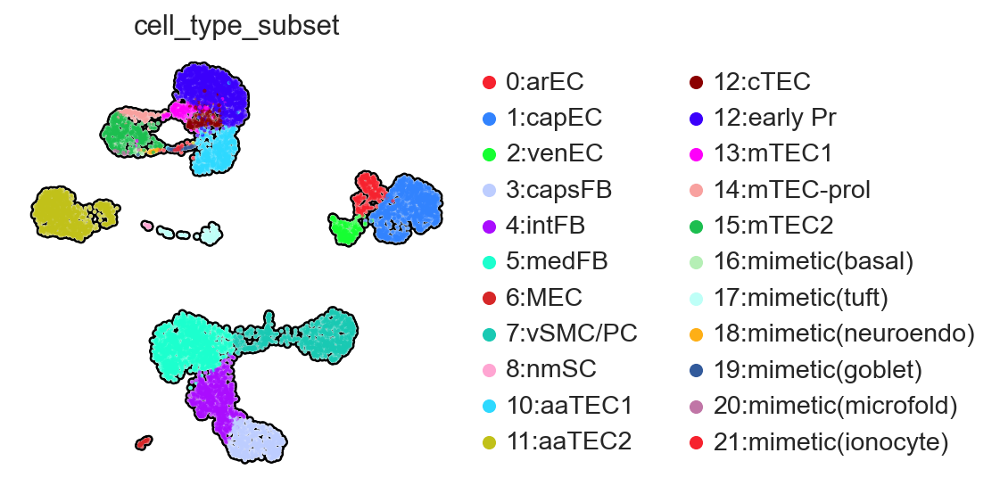

In [107]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

subset_palette =   ['#F6222E', '#3283FE', '#16FF32',  '#BDCDFF', '#AA0DFE','#1CFFCE', '#d62728', '#19c9b3','#FFA5D2',  '#2ED9FF', '#c1c119', '#8b0000', '#3B00FB', '#FE00FA', "#F8A19F", '#1CBE4F','#B5EFB5', '#BEFFF7','#FEAF16', '#325A9B', '#C075A6']

sc.pl.umap(Foxn1LacZ, color=['cell_type_subset'], 
                     color_map='Spectral_r',
                     palette=subset_palette,
                     use_raw=False, 
                     ncols=4, 
                     wspace = 0.3,
                     outline_width=[0.6, 0.05], 
                     size=15,  
                     frameon=False,
                     add_outline=True, 
                     sort_order = False)

In [108]:
path_to_h5ad = '../output/anndata_io/Foxn1LacZ.h5ad'

In [109]:
Foxn1LacZ.write(path_to_h5ad)

In [ ]:
Foxn1LacZ = sc.read_h5ad(path_to_h5ad)
Foxn1LacZ.uns['log1p']["base"] = None